# 5. 画像データの加工可視化

In [68]:
using Images
using StatsBase
using Plots
using ImageSmooth

## 61

In [2]:
ifn = "../../data/chapter-5/data/sample.jpg"
isfile(ifn)

true

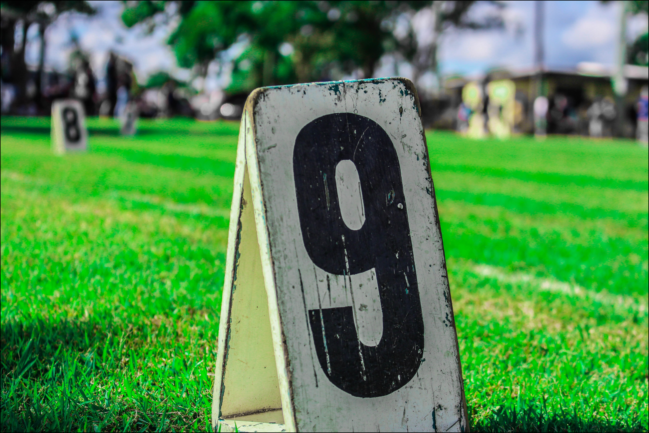

In [3]:
img = load(ifn)

## 62

In [4]:
size(img)

(3456, 5184)

In [5]:
img_arr = channelview(img)

3×3456×5184 reinterpret(reshape, N0f8, ::Array{RGB{N0f8},2}) with eltype N0f8:
[:, :, 1] =
 0.016  0.016  0.012  0.016  0.016  …  0.024  0.027  0.02   0.016  0.012
 0.039  0.039  0.047  0.051  0.059     0.161  0.176  0.188  0.192  0.196
 0.031  0.031  0.035  0.039  0.043     0.075  0.078  0.078  0.071  0.071

[:, :, 2] =
 0.016  0.016  0.012  0.016  0.016  …  0.016  0.02   0.016  0.012  0.004
 0.039  0.039  0.047  0.051  0.059     0.165  0.176  0.184  0.188  0.188
 0.031  0.031  0.035  0.039  0.043     0.067  0.071  0.067  0.067  0.063

[:, :, 3] =
 0.016  0.016  0.012  0.016  0.016  …  0.02   0.012  0.004  0.0    0.0
 0.039  0.039  0.047  0.051  0.059     0.176  0.18   0.18   0.184  0.18
 0.031  0.031  0.035  0.039  0.043     0.071  0.071  0.059  0.059  0.047

;;; … 

[:, :, 5182] =
 0.176  0.188  0.192  0.176  0.157  …  0.161  0.145  0.122  0.098  0.082
 0.271  0.282  0.29   0.286  0.275     0.145  0.133  0.125  0.122  0.125
 0.184  0.196  0.204  0.196  0.18      0.11   0.114  0.106 

In [6]:
img_arr[:, 1, :]

3×5184 Array{N0f8,2} with eltype N0f8:
 0.016  0.016  0.016  0.016  0.016  …  0.184  0.18   0.176  0.184  0.18
 0.039  0.039  0.039  0.039  0.039     0.294  0.278  0.271  0.259  0.255
 0.031  0.031  0.031  0.031  0.031     0.204  0.192  0.184  0.18   0.176

In [7]:
img_arr[:, :, 1]

3×3456 Array{N0f8,2} with eltype N0f8:
 0.016  0.016  0.012  0.016  0.016  …  0.024  0.027  0.02   0.016  0.012
 0.039  0.039  0.047  0.051  0.059     0.161  0.176  0.188  0.192  0.196
 0.031  0.031  0.035  0.039  0.043     0.075  0.078  0.078  0.071  0.071

## 63

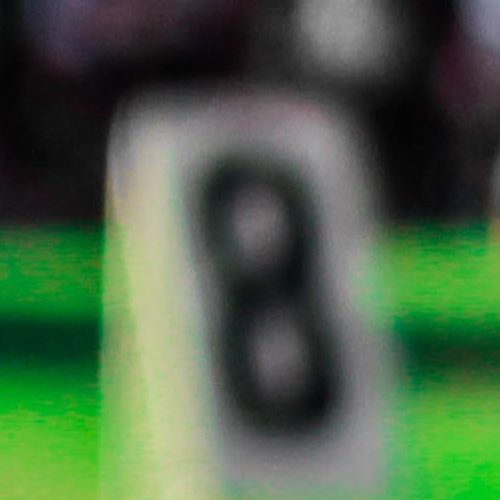

In [8]:
img_extract = img[700:1200-1, 300:800-1]

In [9]:
size(img_extract)

(500, 500)

In [10]:
img_extract_arr = channelview(img_extract)

3×500×500 reinterpret(reshape, N0f8, ::Array{RGB{N0f8},2}) with eltype N0f8:
[:, :, 1] =
 0.039  0.039  0.039  0.039  0.043  …  0.561  0.561  0.549  0.545  0.549
 0.055  0.063  0.063  0.063  0.067     0.765  0.765  0.753  0.749  0.753
 0.051  0.055  0.055  0.055  0.059     0.278  0.278  0.267  0.263  0.267

[:, :, 2] =
 0.031  0.035  0.035  0.027  0.039  …  0.565  0.561  0.549  0.533  0.537
 0.055  0.059  0.059  0.063  0.063     0.761  0.761  0.749  0.745  0.749
 0.047  0.051  0.051  0.051  0.055     0.286  0.286  0.275  0.267  0.271

[:, :, 3] =
 0.027  0.031  0.031  0.024  0.035  …  0.565  0.565  0.549  0.533  0.529
 0.051  0.055  0.055  0.059  0.059     0.761  0.761  0.749  0.745  0.749
 0.043  0.047  0.047  0.047  0.051     0.286  0.286  0.275  0.267  0.267

;;; … 

[:, :, 498] =
 0.518  0.514  0.51   0.506  0.506  …  0.016  0.008  0.016  0.059  0.145
 0.541  0.537  0.533  0.537  0.529     0.788  0.78   0.769  0.773  0.776
 0.635  0.631  0.627  0.627  0.624     0.098  0.09   0.086 

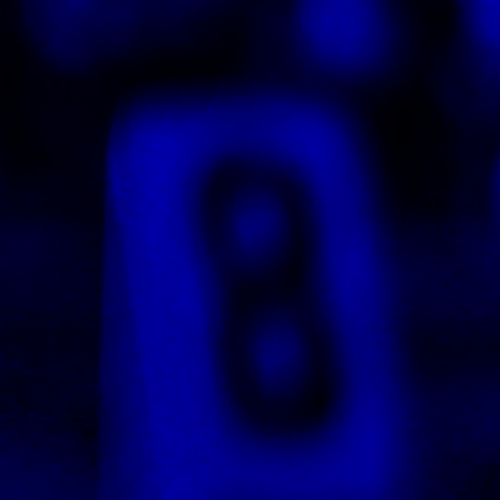

In [11]:
bimg_extract_arr = copy(img_extract_arr)
bimg_extract_arr[1:2, :, :] .= 0
colorview(RGB, bimg_extract_arr)

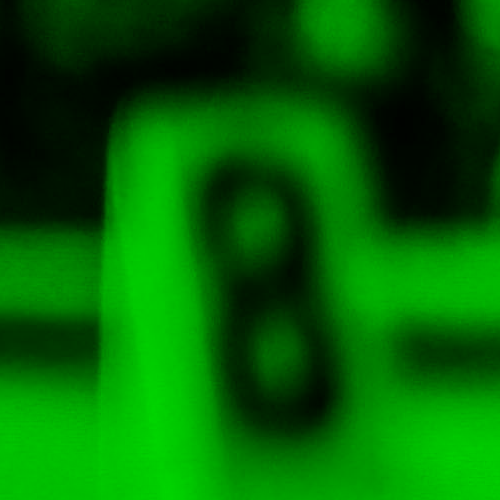

In [12]:
gimg_extract_arr = copy(img_extract_arr)
gimg_extract_arr[1:2:3, :, :] .= 0
colorview(RGB, gimg_extract_arr)

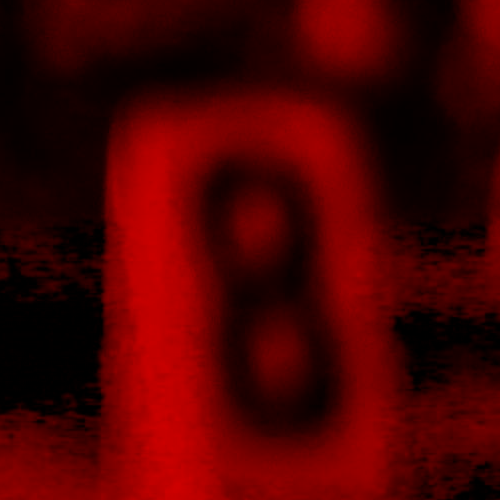

In [13]:
rimg_extract_arr = copy(img_extract_arr)
rimg_extract_arr[2:1:3, :, :] .= 0
colorview(RGB, rimg_extract_arr)

## 64

In [14]:
rhist = countmap([x for x in img_arr[1, :, :] .* 255])
ghist = countmap([x for x in img_arr[2, :, :] .* 255])
bhist = countmap([x for x in img_arr[3, :, :] .* 255])

Dict{Float32, Int64} with 256 entries:
  56.0  => 150258
  35.0  => 206082
  60.0  => 140054
  220.0 => 28291
  67.0  => 103374
  215.0 => 24492
  73.0  => 71266
  251.0 => 4
  115.0 => 46498
  112.0 => 44998
  185.0 => 21765
  86.0  => 44933
  168.0 => 28922
  207.0 => 23078
  242.0 => 327
  183.0 => 22099
  224.0 => 35266
  177.0 => 23151
  12.0  => 101017
  ⋮     => ⋮

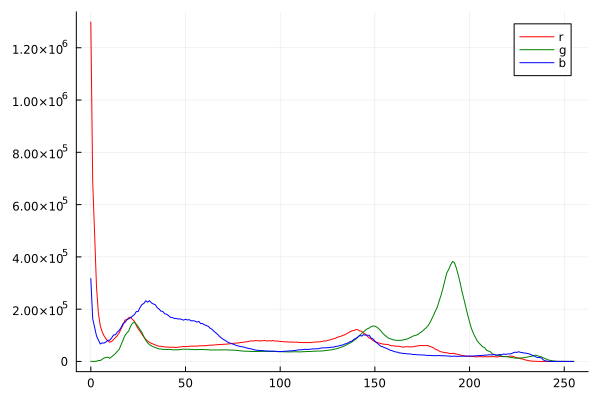

In [15]:
plot(rhist, label="r", color=:red)
plot!(ghist, label="g", color=:green)
plot!(bhist, label="b", color=:blue)

# 65

In [24]:
img_arr_gbr = copy(img_arr)
img_arr_gbr[:, :, :] = img_arr_gbr[end:-1:begin, :, :]

3×3456×5184 Array{N0f8,3} with eltype N0f8:
[:, :, 1] =
 0.031  0.031  0.035  0.039  0.043  …  0.075  0.078  0.078  0.071  0.071
 0.039  0.039  0.047  0.051  0.059     0.161  0.176  0.188  0.192  0.196
 0.016  0.016  0.012  0.016  0.016     0.024  0.027  0.02   0.016  0.012

[:, :, 2] =
 0.031  0.031  0.035  0.039  0.043  …  0.067  0.071  0.067  0.067  0.063
 0.039  0.039  0.047  0.051  0.059     0.165  0.176  0.184  0.188  0.188
 0.016  0.016  0.012  0.016  0.016     0.016  0.02   0.016  0.012  0.004

[:, :, 3] =
 0.031  0.031  0.035  0.039  0.043  …  0.071  0.071  0.059  0.059  0.047
 0.039  0.039  0.047  0.051  0.059     0.176  0.18   0.18   0.184  0.18
 0.016  0.016  0.012  0.016  0.016     0.02   0.012  0.004  0.0    0.0

;;; … 

[:, :, 5182] =
 0.184  0.196  0.204  0.196  0.18   …  0.11   0.114  0.106  0.106  0.102
 0.271  0.282  0.29   0.286  0.275     0.145  0.133  0.125  0.122  0.125
 0.176  0.188  0.192  0.176  0.157     0.161  0.145  0.122  0.098  0.082

[:, :, 5183] =
 0.18

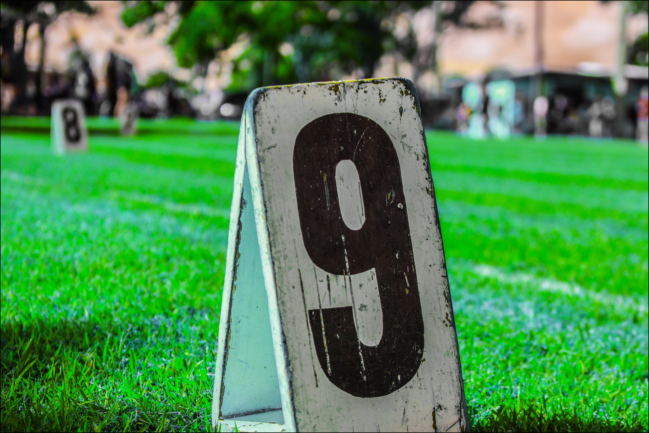

In [26]:
colorview(RGB, img_arr_gbr)

# 66

In [34]:
channels, height, width = size(img_arr)

(3, 3456, 5184)

In [35]:
println(width, " ", height)

5184 3456


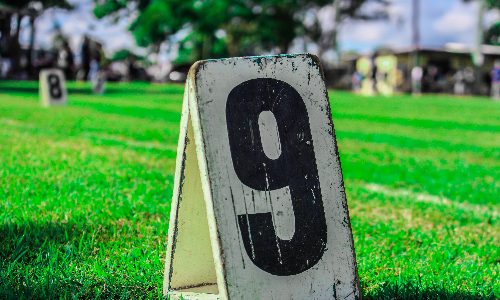

In [37]:
img_resized = imresize(img, 300, 500)

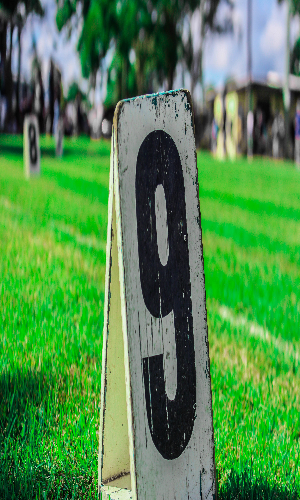

In [38]:
img_resized = imresize(img, 500, 300)

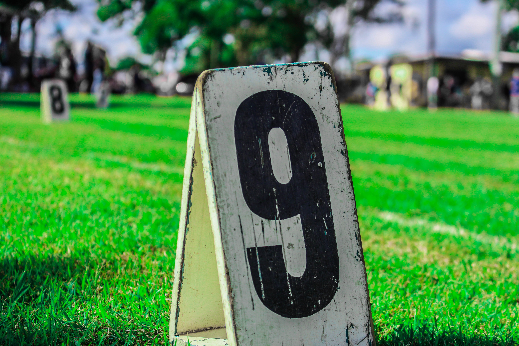

In [41]:
img_resized = imresize(img; ratio=0.1)

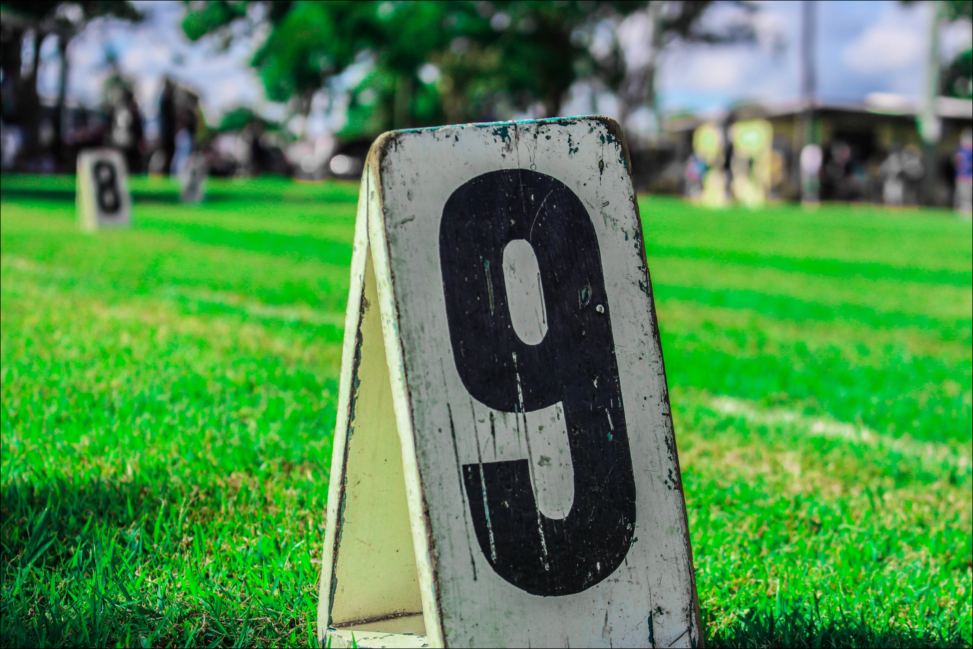

In [42]:
img_resized = imresize(img; ratio=1.5)

## 67

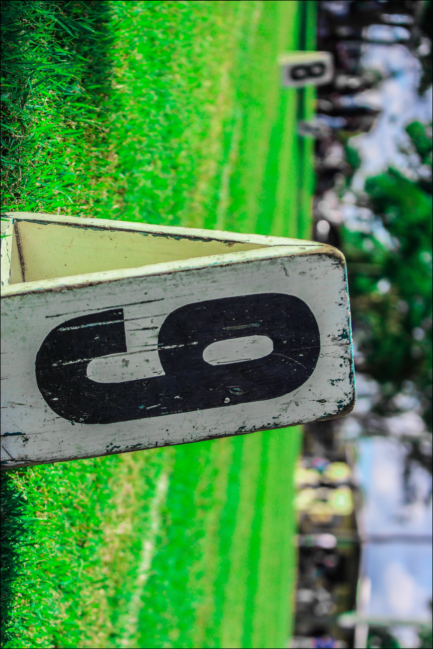

In [46]:
imrotate(img, pi / 2)

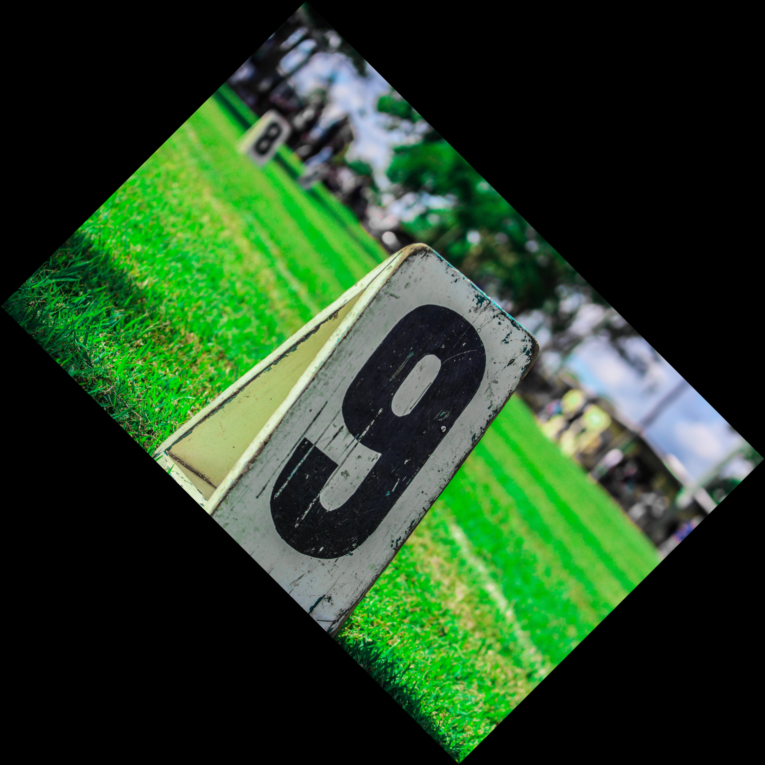

In [47]:
imrotate(img, pi / 4)

In [54]:
img_arr_flip = copy(img_arr)
img_arr_flip[:, :, :] = img_arr_flip[:, end:-1:begin, :]

3×3456×5184 Array{N0f8,3} with eltype N0f8:
[:, :, 1] =
 0.012  0.016  0.02   0.027  0.024  …  0.016  0.016  0.012  0.016  0.016
 0.196  0.192  0.188  0.176  0.161     0.059  0.051  0.047  0.039  0.039
 0.071  0.071  0.078  0.078  0.075     0.043  0.039  0.035  0.031  0.031

[:, :, 2] =
 0.004  0.012  0.016  0.02   0.016  …  0.016  0.016  0.012  0.016  0.016
 0.188  0.188  0.184  0.176  0.165     0.059  0.051  0.047  0.039  0.039
 0.063  0.067  0.067  0.071  0.067     0.043  0.039  0.035  0.031  0.031

[:, :, 3] =
 0.0    0.0    0.004  0.012  0.02   …  0.016  0.016  0.012  0.016  0.016
 0.18   0.184  0.18   0.18   0.176     0.059  0.051  0.047  0.039  0.039
 0.047  0.059  0.059  0.071  0.071     0.043  0.039  0.035  0.031  0.031

;;; … 

[:, :, 5182] =
 0.082  0.098  0.122  0.145  0.161  …  0.157  0.176  0.192  0.188  0.176
 0.125  0.122  0.125  0.133  0.145     0.275  0.286  0.29   0.282  0.271
 0.102  0.106  0.106  0.114  0.11      0.18   0.196  0.204  0.196  0.184

[:, :, 5183] =
 0

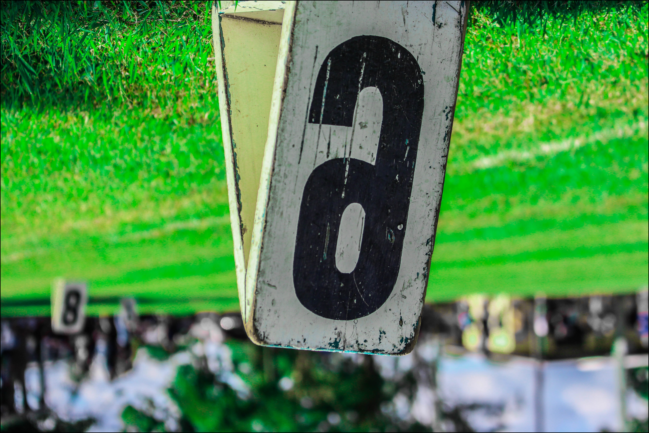

In [55]:
colorview(RGB, img_arr_flip)

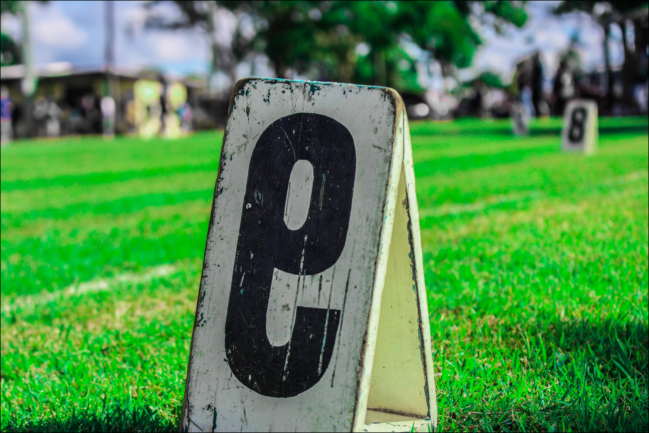

In [56]:
img_arr_flip = copy(img_arr)
img_arr_flip[:, :, :] = img_arr_flip[:, :, end:-1:begin]
colorview(RGB, img_arr_flip)

## 68

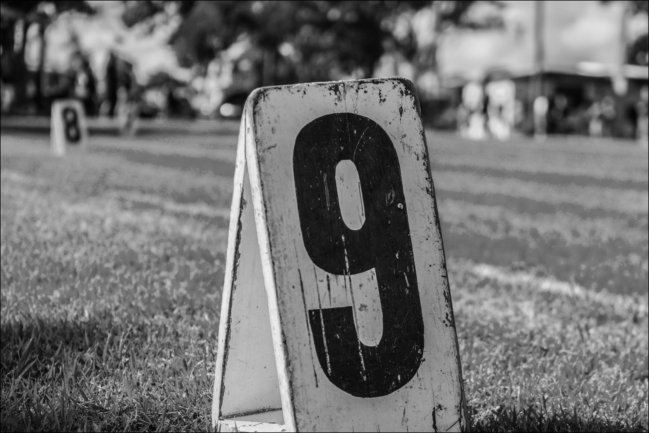

In [57]:
Gray.(img)

In [58]:
img_arr_th = copy(img_arr)

3×3456×5184 Array{N0f8,3} with eltype N0f8:
[:, :, 1] =
 0.016  0.016  0.012  0.016  0.016  …  0.024  0.027  0.02   0.016  0.012
 0.039  0.039  0.047  0.051  0.059     0.161  0.176  0.188  0.192  0.196
 0.031  0.031  0.035  0.039  0.043     0.075  0.078  0.078  0.071  0.071

[:, :, 2] =
 0.016  0.016  0.012  0.016  0.016  …  0.016  0.02   0.016  0.012  0.004
 0.039  0.039  0.047  0.051  0.059     0.165  0.176  0.184  0.188  0.188
 0.031  0.031  0.035  0.039  0.043     0.067  0.071  0.067  0.067  0.063

[:, :, 3] =
 0.016  0.016  0.012  0.016  0.016  …  0.02   0.012  0.004  0.0    0.0
 0.039  0.039  0.047  0.051  0.059     0.176  0.18   0.18   0.184  0.18
 0.031  0.031  0.035  0.039  0.043     0.071  0.071  0.059  0.059  0.047

;;; … 

[:, :, 5182] =
 0.176  0.188  0.192  0.176  0.157  …  0.161  0.145  0.122  0.098  0.082
 0.271  0.282  0.29   0.286  0.275     0.145  0.133  0.125  0.122  0.125
 0.184  0.196  0.204  0.196  0.18      0.11   0.114  0.106  0.106  0.102

[:, :, 5183] =
 0.18

In [59]:
for i in 1:size(img_arr_th)[1]
    for j in 1:size(img_arr_th)[2]
        for k in 1:size(img_arr_th)[3]
            img_arr_th[i, j, k] = img_arr_th[i, j, k] * 255 > 60 ? 1 : 0
        end
    end
end


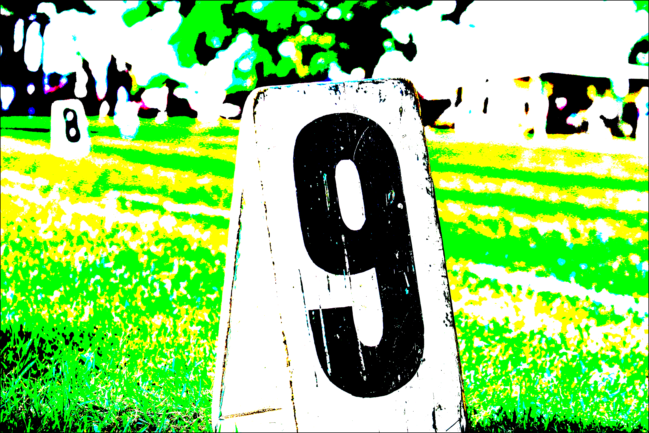

In [60]:
colorview(RGB, img_arr_th)

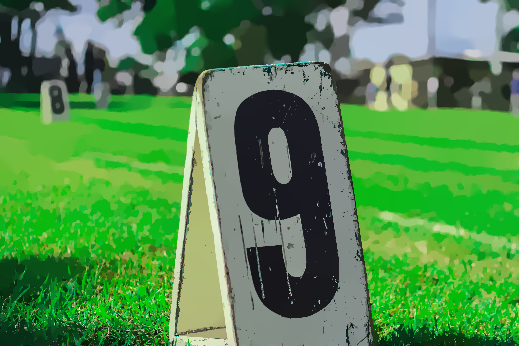

In [78]:
smooth(imresize(img; ratio=0.1), L0Smooth())

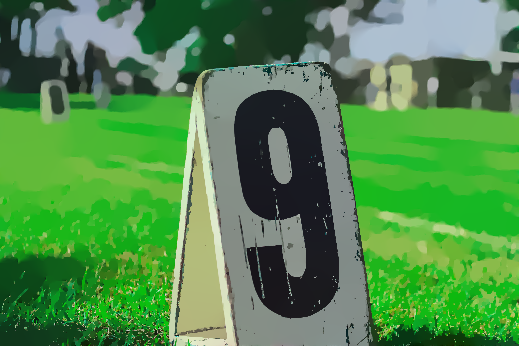

In [79]:
smooth(imresize(img; ratio=0.1), L0Smooth(λ=4e-2, κ=2.0, βmax=1e5))

## 69

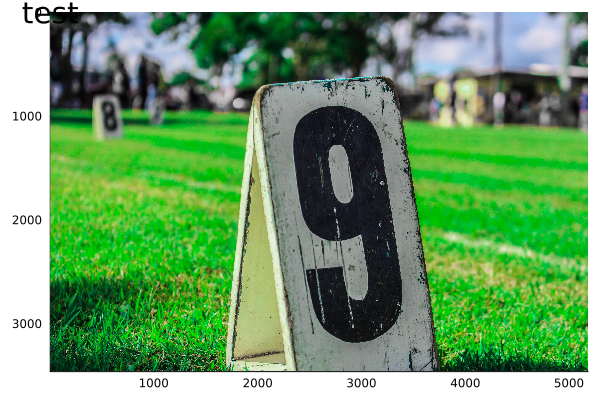

In [80]:
plot(img)
annotate!(1.,1.,text("test",20))

## 70

In [81]:
save("./img_resized.jpg", img_resized)

4757449